<a href="https://colab.research.google.com/github/andrewwoood/rnn_music_generation/blob/main/RNN_Music_Generation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Generating Irish folk Music with a LSTM type RNN

Installing dependencies and importing packages

In [ ]:
# Import Tensorflow 2.0
%tensorflow_version 2.x
import tensorflow as tf 

# Download and import the MIT 6.S191 package
!pip install mitdeeplearning
import mitdeeplearning as mdl

# Import all remaining packages
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

### Obtaining the training data
I obtain the training data here using the MIT Deep Learning package and print out an example song so that we can be clear on how our music is stored.

ABC format is structured as follows:
- X denotes a reference number
- M denotes Meter
- K denotes the Key
- L denotes the beats
- T denotes the Title
- Z denotes the transcription 
- The rest are notes that denote the melody for the song.

In [ ]:
# Downloading the dataset
songs = mdl.lab1.load_training_data()

# Print out a song so we can examine the structure of ABC format
example_song = songs[0]
print('\nExample Song is:')
print(example_song)

Found 816 songs in text

Example Song is:
X:2
T:An Buachaill Dreoite
Z: id:dc-hornpipe-2
M:C|
L:1/8
K:G Major
GF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!
DGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!
GA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!
B2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|!


To listen to a given song, we can use a function included in the MDL package to convert a song in ABC to .wav format.

In [ ]:
# Converts an ABC song to audio
mdl.lab1.play_song(example_song)

Next, we define a vocabulary. Because the idea of our RNN is to predict the next output given a sequence of inputs, we have to be able to analyze and understand what is coming in. Therefore, we will determine all the possible input characters and then map them to a number. 

In [ ]:
# If we want to look at all the possible characters, we must consider every song.
songs_joined = "\n\n".join(songs)

# Determine all unique characters.
vocabulary = sorted(set(songs_joined))
print("The number of unique characters that our dataset contains is {}.".format(len(vocabulary)))

The number of unique characters that our dataset contains is 83.


Determining a mapping for our characters:

In [ ]:
# This line declares a dictionary that goes through enumerate elementwise, assigning each tuple 
#   to a key:value pair while flipping the order of the elements within the tuple.
char2idx = {letter:index for index, letter in enumerate(vocabulary)}

# Since we sorted the vocabulary before this block of code, turning vocab into an array yields the
#   mapping of index to character.
idx2char = np.array(vocabulary)

print(char2idx)
print(idx2char)

{'\n': 0, ' ': 1, '!': 2, '"': 3, '#': 4, "'": 5, '(': 6, ')': 7, ',': 8, '-': 9, '.': 10, '/': 11, '0': 12, '1': 13, '2': 14, '3': 15, '4': 16, '5': 17, '6': 18, '7': 19, '8': 20, '9': 21, ':': 22, '<': 23, '=': 24, '>': 25, 'A': 26, 'B': 27, 'C': 28, 'D': 29, 'E': 30, 'F': 31, 'G': 32, 'H': 33, 'I': 34, 'J': 35, 'K': 36, 'L': 37, 'M': 38, 'N': 39, 'O': 40, 'P': 41, 'Q': 42, 'R': 43, 'S': 44, 'T': 45, 'U': 46, 'V': 47, 'W': 48, 'X': 49, 'Y': 50, 'Z': 51, '[': 52, ']': 53, '^': 54, '_': 55, 'a': 56, 'b': 57, 'c': 58, 'd': 59, 'e': 60, 'f': 61, 'g': 62, 'h': 63, 'i': 64, 'j': 65, 'k': 66, 'l': 67, 'm': 68, 'n': 69, 'o': 70, 'p': 71, 'q': 72, 'r': 73, 's': 74, 't': 75, 'u': 76, 'v': 77, 'w': 78, 'x': 79, 'y': 80, 'z': 81, '|': 82}
['\n' ' ' '!' '"' '#' "'" '(' ')' ',' '-' '.' '/' '0' '1' '2' '3' '4' '5'
 '6' '7' '8' '9' ':' '<' '=' '>' 'A' 'B' 'C' 'D' 'E' 'F' 'G' 'H' 'I' 'J'
 'K' 'L' 'M' 'N' 'O' 'P' 'Q' 'R' 'S' 'T' 'U' 'V' 'W' 'X' 'Y' 'Z' '[' ']'
 '^' '_' 'a' 'b' 'c' 'd' 'e' 'f' 'g' 'h' 

Next we have to use the mapping we just created to turn an input string into a sequence of numbers. 

In [ ]:
# Vectorize_string will take any string as an input, iterate through the string by character and then
#  using the mapping above return a list of numbers, then use numpy to convert it to an array which
#  we then return.
def vectorize_string(string):
    vectorized_output = np.array([char2idx[char] for char in string])
    return vectorized_output

vectorized_songs = vectorize_string(songs_joined)
print(vectorized_songs)

[49 22 14 ... 22 82  2]


Formulating the training set:


In [ ]:
def get_batch(vectorized_songs, seq_length, batch_size):
  # Length of the vectorized songs string.
  n = len(vectorized_songs) - 1

  # Choose the indices of the samples we will be using to train. We choose an index of size batch_size 
  #   anywhere from the beginning of the list to the end minus sequence length.
  idx = np.random.choice(n-seq_length, batch_size)

  # From the indices chosen, assign the target sequence
  input_batch = [vectorized_songs[i : i+seq_length] for i in idx]

  # From the indices chosen, assign the target sequence but one character over, the last char is the 
  #   char that we will be predicting given the input.
  output_batch = [vectorized_songs[i+1 : i+seq_length+1] for i in idx]

  # Cleaning up the input and output so that we can feed it into the network more easily
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])
  return x_batch, y_batch

Here is a more human representation of how we are looking at the data:

In [ ]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
    print("Step {:3d}".format(i))
    print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
    print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))

Step   0
  input: 60 ('e')
  expected output: 0 ('\n')
Step   1
  input: 0 ('\n')
  expected output: 51 ('Z')
Step   2
  input: 51 ('Z')
  expected output: 22 (':')
Step   3
  input: 22 (':')
  expected output: 1 (' ')
Step   4
  input: 1 (' ')
  expected output: 64 ('i')


### Defining the RNN model

Here we will specifically be using an LSTM network. We use this type of RNN because it is robust against the problems of long-term dependency (e.g. If the most important word in a sentence was near the beginning) and backpropagation is easier to perform (and we won't run into exploding or vanishing gradients).

In [ ]:
def LSTM(rnn_units): 
  return tf.keras.layers.LSTM(
    rnn_units, 
    return_sequences=True, 
    recurrent_initializer='glorot_uniform',
    recurrent_activation='sigmoid',
    stateful=True,
  )

def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    # Embedding layer will take any letter from our vocabulary and convert it into a vector, which will
    #   then be used for training.
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),

    # Dimensionality of the output of this layer should be the number of units we want
    LSTM(rnn_units),

    # Last layer should output to predict one character from our vocabulary space
    tf.keras.layers.Dense(vocab_size)
  ])

  return model

# Build a simple model with default hyperparameters so we can view the summary
model = build_model(len(vocabulary), embedding_dim=256, rnn_units=1024, batch_size=32)

model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (32, None, 256)           21248     
_________________________________________________________________
lstm (LSTM)                  (32, None, 1024)          5246976   
_________________________________________________________________
dense (Dense)                (32, None, 83)            85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [ ]:
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
pred = model(x)
print("Input shape:      ", x.shape, " # (batch_size, sequence_length)")
print("Prediction shape: ", pred.shape, "# (batch_size, sequence_length, vocab_size)")

Input shape:       (32, 100)  # (batch_size, sequence_length)
Prediction shape:  (32, 100, 83) # (batch_size, sequence_length, vocab_size)


### Training the model
To being training the model, we must define a loss function and the gradient operations that we will be using in backpropagation. 

For loss we use the crossentropy loss function from tensorflow where labels are our real targets and logits are what our model is predicting.

In [ ]:
# Here, tensorflow does most of the work for us with its built in function.
def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)
  return loss

example_batch_loss = compute_loss(y, pred)

print("Prediction shape: ", pred.shape, " # (batch_size, sequence_length, vocab_size)") 
print("scalar_loss:      ", example_batch_loss.numpy().mean())

Prediction shape:  (32, 100, 83)  # (batch_size, sequence_length, vocab_size)
scalar_loss:       4.4185023


Here is the hyperparamter setup. We can tune these as I've commented in order to change how our model will learn.

In [ ]:
### Hyperparameter setting and optimization ###

# Optimization parameters:
num_training_iterations = 2000  # How many training iterations we want to go through
batch_size = 4  # The number of samples that will be passed into the network at once
seq_length = 100  # How many characters we want to have in one input sequence
learning_rate = 5e-3  # The coefficient eta in our gradient descent. In other words, this is how much
                              #   we trust that our gradient is guiding us in the right direction.

# Model parameters: 
vocab_size = len(vocabulary)
embedding_dim = 256 
rnn_units = 1024

# Checkpoint location so we can seed a new, trained model: 
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

####Defining optimization and training
The tensorflow documentation has many different optimizers, here Adam is chosen arbitrarily. Try more out here: https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/

The backpropagation is done by tf.GradientTape method.

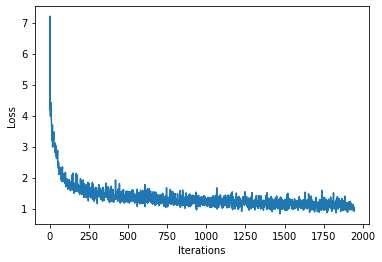

100%|██████████| 2000/2000 [00:52<00:00, 37.74it/s]


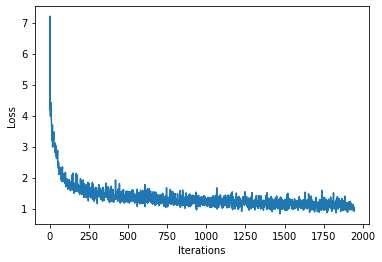

In [ ]:
### Define optimizer and training operation ###

model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)
optimizer = tf.keras.optimizers.Adam(learning_rate)

@tf.function
def train_step(x, y): 
  with tf.GradientTape() as tape:
    # Our predicted output given input.
    y_hat = model(x)
    # From above, computing the crossentropy loss between what our model says and what we know.
    loss = compute_loss(y, y_hat) 

  # Now, compute the gradients. Grads is the gradient of loss w.r.t. the weights.
  grads = tape.gradient(loss, model.trainable_variables)
  # Built in method for applying gradients to our weights from the Optimizer class.
  optimizer.apply_gradients(zip(grads, model.trainable_variables))
  return loss

##################
# Begin training!#
##################

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear() # clear if it exists

for iter in tqdm(range(num_training_iterations)):

  # Grab a batch and propagate it through the network
  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)

  # Update the progress bar
  history.append(loss.numpy().mean())
  plotter.plot(history)

  # Update the model with the changed weights!
  if iter % 100 == 0:     
    model.save_weights(checkpoint_prefix)
    
# Save the trained model and the weights
model.save_weights(checkpoint_prefix)

###Generating music using the our trained model:
Restoring the weights from the last checkpoint and viewing a summary of what we have.

In [ ]:
# Rebuilding the model with a batch size of 1
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1)

# Restore the model with the trained weights that were updated at the end of the above block
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      (1, None, 256)            21248     
_________________________________________________________________
lstm_2 (LSTM)                (1, None, 1024)           5246976   
_________________________________________________________________
dense_2 (Dense)              (1, None, 83)             85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


###Prediction procedure
In order to predict and generate, we define a function generate_text. When we call generate_text, we supply it with our model, a starting seed (what character we want our model to start generating from), and the length of text we want to generate. From the starting string, we use the state of the RNN to obtain the probability distribution over the next predicted character. Since our RNN outputs a softmax over the characters we give it, we sample from a multinomial distribution to obtain the index of the output. Then we take the predicted character and use that as an input for the next unit in the LSTM chain.

In [ ]:
def generate_text(model, start_string, generation_length=1000):
  # Evaluation step (generating ABC text using the learned RNN model)
  input_eval = [char2idx[s] for s in start_string] 
  input_eval = tf.expand_dims(input_eval, 0)

  # Empty string to store our results
  text_generated = []

  # Here batch size == 1
  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
      predictions = model(input_eval)
      
      # Remove the batch dimension, i.e. removes all dimensions of size 1 from the tensor
      predictions = tf.squeeze(predictions, 0)
      # Sample from a categorical distribution 
      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()
      
      # Pass the prediction along with the previous hidden state
      #   as the next inputs to the model
      input_eval = tf.expand_dims([predicted_id], 0)
      # 
      text_generated.append(idx2char[predicted_id])

    
  return (start_string + ''.join(text_generated))

# Here we set the start_string to be "X"
generated_text = generate_text(model, start_string="X", generation_length=1000) 

100%|██████████| 1000/1000 [00:04<00:00, 208.00it/s]


Play back the generated music

In [ ]:
# Using the MIT Deep Learning package to extract the music we have generated
generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs): 
  # Synthesize the waveform from a song
  waveform = mdl.lab1.play_song(song)

  # If its a valid song (correct syntax), lets play it! 
  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

Found 4 songs in text
Generated song 1


Generated song 2


Generated song 3
